**Atividade**

Agora é hora de aplicar o que aprendemos em sala.

Escolha um dos Dataset abaixo e treine um modelo de visão computacional para classificar as imagens. Explore o máximo do conteúdo vimos até aqui. Fale sobre a arquitetura usada, estratégia, resultado e conclusão.

*	Classificação de grãos de café – Conjunto de dados com imagens de grãos de café para classificação do nível de torrefação (Dark, Green, Light, Medium):
https://www.kaggle.com/datasets/gpiosenka/coffee-bean-dataset-resized-224-x-224

*	Classificação de gado por raça – Conjunto de dados com imagens de gados de diferentes raças para classificação (ex. Belmont, Gir, Jersey, etc.):
https://www.kaggle.com/datasets/iamshahadat/cattle

*	Detecção de insetos e pragas agrícolas em imagens – Conjunto com 12 diferentes espécies insetos e pragas agrícolas:
https://www.kaggle.com/datasets/vencerlanz09/agricultural-pests-image-dataset



# Detecção de insetos e pragas agrícolas em imagens

In [1]:
! kaggle datasets download -d vencerlanz09/agricultural-pests-image-dataset

Dataset URL: https://www.kaggle.com/datasets/vencerlanz09/agricultural-pests-image-dataset
License(s): copyright-authors
 94% 96.0M/102M [00:02<00:00, 51.9MB/s]
100% 102M/102M [00:02<00:00, 43.6MB/s] 


In [2]:
!unzip /content/agricultural-pests-image-dataset.zip

A saída de streaming foi truncada nas últimas 5000 linhas.
  inflating: ants/ants (95).jpg      
  inflating: ants/ants (96).jpg      
  inflating: ants/ants (97).jpg      
  inflating: ants/ants (98).jpg      
  inflating: ants/ants (99).jpg      
  inflating: bees/bees (1).jpg       
  inflating: bees/bees (10).jpg      
  inflating: bees/bees (100).jpg     
  inflating: bees/bees (101).jpg     
  inflating: bees/bees (102).jpg     
  inflating: bees/bees (103).jpg     
  inflating: bees/bees (104).jpg     
  inflating: bees/bees (105).jpg     
  inflating: bees/bees (106).jpg     
  inflating: bees/bees (107).jpg     
  inflating: bees/bees (108).jpg     
  inflating: bees/bees (109).jpg     
  inflating: bees/bees (11).jpg      
  inflating: bees/bees (110).jpg     
  inflating: bees/bees (111).jpg     
  inflating: bees/bees (112).jpg     
  inflating: bees/bees (113).jpg     
  inflating: bees/bees (114).jpg     
  inflating: bees/bees (115).jpg     
  inflating: bees/bees (116).

In [3]:
!apt-get install tree
!tree -d /content/

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  tree
0 upgraded, 1 newly installed, 0 to remove and 45 not upgraded.
Need to get 47.9 kB of archives.
After this operation, 116 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tree amd64 2.0.2-1 [47.9 kB]
Fetched 47.9 kB in 0s (112 kB/s)
Selecting previously unselected package tree.
(Reading database ... 123586 files and directories currently installed.)
Preparing to unpack .../tree_2.0.2-1_amd64.deb ...
Unpacking tree (2.0.2-1) ...
Setting up tree (2.0.2-1) ...
Processing triggers for man-db (2.10.2-1) ...
/content/
├── ants
├── bees
├── beetle
├── catterpillar
├── earthworms
├── earwig
├── grasshopper
├── moth
├── sample_data
├── slug
├── snail
├── wasp
└── weevil

13 directories


In [4]:
import os
from PIL import Image
import matplotlib.pyplot as plt
import tensorflow as tf
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing import image_dataset_from_directory
import numpy as np
import matplotlib.pyplot as plt
import shutil
import tensorflow as tf
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
import tensorflow as tf
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.models import Model

In [5]:
# Caminho para o diretório de dados
data_dir = "/content"

# Criar dataset a partir do diretório
dataset = image_dataset_from_directory(
    data_dir,
    labels='inferred',
    label_mode='int',
    image_size=(512, 512), # Tamanho das imagens
    batch_size=32, # Tamanho do lote
    shuffle=True
)

Found 5494 files belonging to 13 classes.


In [6]:
class_names = dataset.class_names
print(np.asarray(class_names).reshape(-1,1))

[['ants']
 ['bees']
 ['beetle']
 ['catterpillar']
 ['earthworms']
 ['earwig']
 ['grasshopper']
 ['moth']
 ['sample_data']
 ['slug']
 ['snail']
 ['wasp']
 ['weevil']]


In [7]:
for image_batch, label_batch in dataset.take(1):
  print(image_batch)
  print(label_batch)

tf.Tensor(
[[[[232.        232.        234.       ]
   [232.        232.        234.       ]
   [232.        232.        234.       ]
   ...
   [215.        214.        220.       ]
   [215.        214.        220.       ]
   [215.        214.        220.       ]]

  [[232.        232.        234.       ]
   [232.        232.        234.       ]
   [232.        232.        234.       ]
   ...
   [215.        214.        220.       ]
   [215.        214.        220.       ]
   [215.        214.        220.       ]]

  [[232.        232.        234.       ]
   [232.        232.        234.       ]
   [232.        232.        234.       ]
   ...
   [215.        214.        220.       ]
   [215.        214.        220.       ]
   [215.        214.        220.       ]]

  ...

  [[231.        231.        233.       ]
   [231.        231.        233.       ]
   [231.        231.        233.       ]
   ...
   [214.        215.        220.       ]
   [214.        215.        220.       ]
   [2

In [8]:
train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = int(0.1 * len(dataset))

# Normalização das imagens (0-255 para 0-1)
normalization_layer = tf.keras.layers.Rescaling(1./255)
normalized_ds = dataset.map(lambda x, y: (normalization_layer(x), y))

train_ds = dataset.take(train_size)
val_ds = dataset.skip(train_size).take(val_size)
test_ds = dataset.skip(train_size + val_size).take(test_size)


print('Proporção dos dados de Treino Teste e Validção dentro do Batch')
print(f'batch: {len(dataset)}')
print(f'Train: {train_size}')
print(f'Test: {test_size}')
print(f'Validation : {val_size}')

Proporção dos dados de Treino Teste e Validção dentro do Batch
batch: 172
Train: 137
Test: 17
Validation : 17


In [9]:
# Função para plotar uma amostra do dataset
def plot_sample_from_dataset(dataset, num_images):
    # Pegar um lote de amostras do dataset
    for image_batch, label_batch in dataset.take(1):
        plt.figure(figsize=(10, 10))
        for i in range(num_images):
            ax = plt.subplot(5, 5, i + 1)
            plt.imshow(image_batch[i].numpy().astype("uint8"))
            plt.title(f'Amostra: {label_batch[i].numpy()}')
            plt.axis("off")
        plt.show()


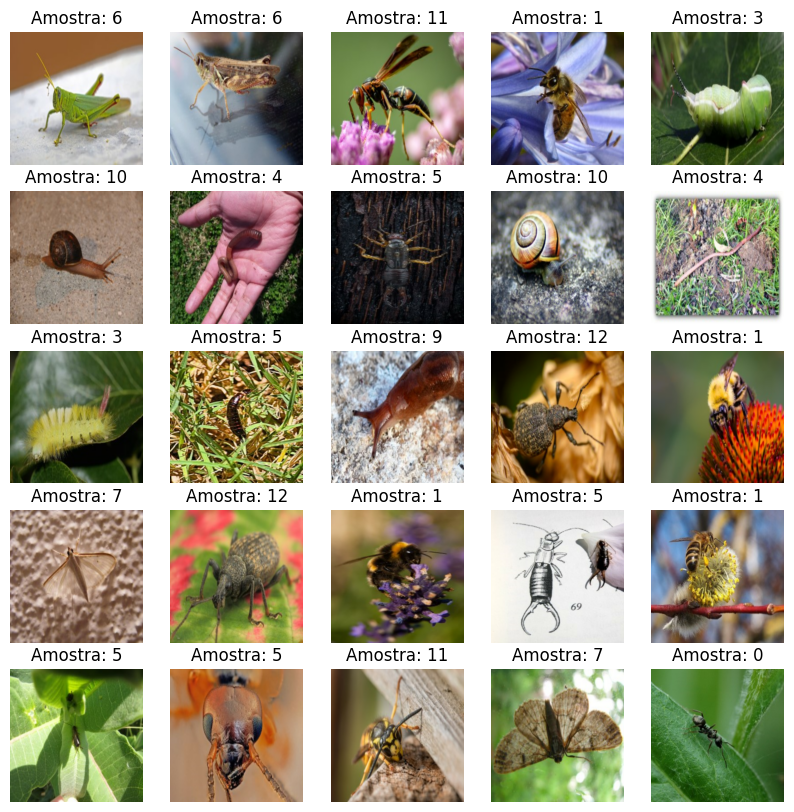

In [10]:
# Plotar uma amostra do dataset de treino
plot_sample_from_dataset(train_ds, 25)  # Ajuste o número de imagens conforme necessário

In [12]:
# Obter nomes das classes
class_names = dataset.class_names

# Função para plotar uma amostra do dataset
def plot_sample_from_dataset(dataset, num_images, class_names):
    # Pegar um lote de amostras do dataset
    for image_batch, label_batch in dataset.take(1):
        plt.figure(figsize=(20, 20))
        for i in range(num_images):
            ax = plt.subplot(5, 5, i + 1)
            plt.imshow(image_batch[i].numpy().astype("uint8"))
            class_label = class_names[label_batch[i].numpy()]
            plt.title(f'Label: {label_batch[i].numpy()}\nClasse: {class_label}')
            plt.axis("off")
        plt.show()



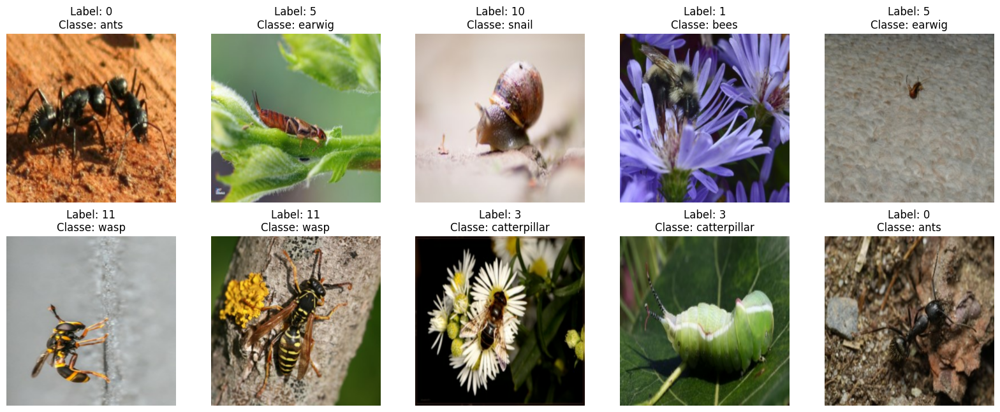

In [13]:
# Plotar uma amostra do dataset de treino
plot_sample_from_dataset(train_ds, 10, class_names)  # Ajuste o número de imagens conforme necessário

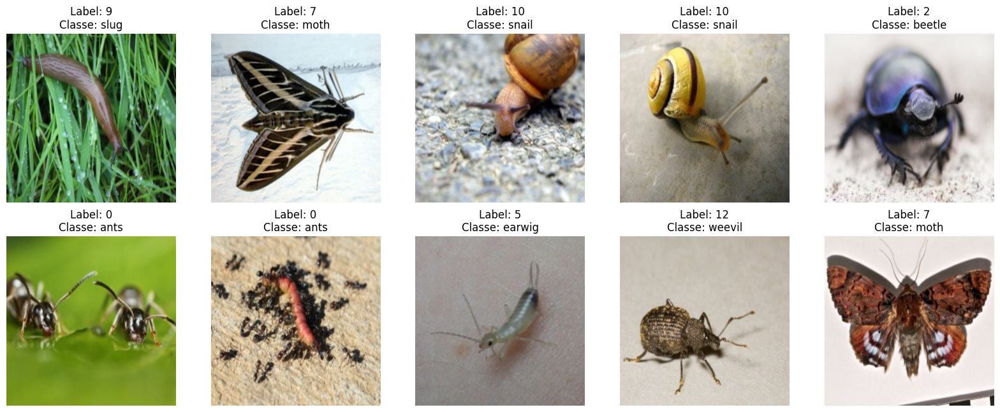

In [14]:
# Plotar uma amostra do dataset de teste
plot_sample_from_dataset(test_ds, 10, class_names)  # Ajuste o número de imagens conforme necessário

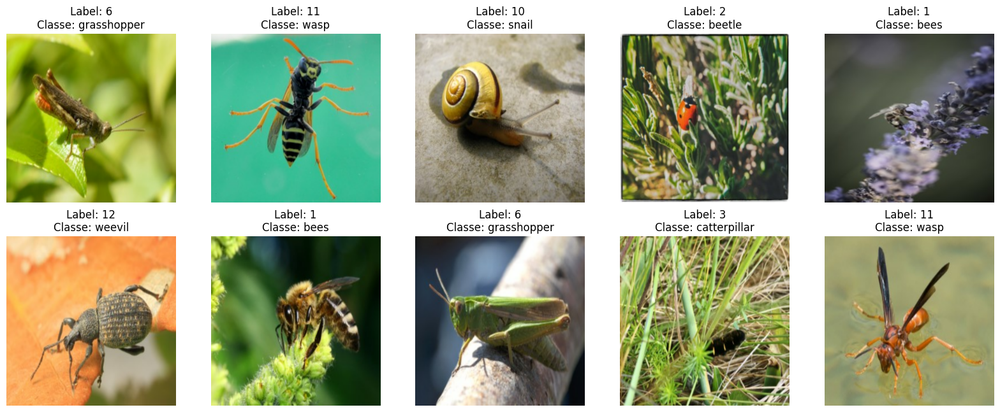

In [15]:
# Plotar uma amostra do dataset de validação
plot_sample_from_dataset(val_ds, 10, class_names)  # Ajuste o número de imagens conforme necessário

In [16]:
num_classes = len(class_names)
print(num_classes)

13


Construindo a rede

In [18]:
# Carregar o modelo pré-treinado EfficientNetV2L sem a camada de classificação final
pretrained_model = tf.keras.applications.efficientnet_v2.EfficientNetV2L(
    input_shape=(512, 512, 3),
    include_top=False,
    weights='imagenet',
    pooling='avg'  # Usa GlobalAveragePooling2D para reduzir a dimensionalidade
)


# Congelar as camadas do modelo pré-treinado
pretrained_model.trainable = False

473176280/473176280 [==============================] - 2s 0us/step


In [19]:
# Adicionar camadas personalizadas no topo do modelo pré-treinado
# Adicionar camadas personalizadas no topo do modelo pré-treinado
inputs = pretrained_model.input
x = pretrained_model.output  # Esta saída já está poolada globalmente
x = Dense(128, activation='relu')(x)  # Camada densa com 128 unidades e ativação ReLU
x = Dropout(0.5)(x)  # Adicionar Dropout para evitar overfitting
outputs = Dense(num_classes, activation='softmax')(x)  # Camada de saída com 12 classes


# Criar o modelo final
model = Model(inputs=inputs, outputs=outputs)


**Visualizando a estrutura da rede**

In [20]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 rescaling_1 (Rescaling)     (None, 512, 512, 3)          0         ['input_2[0][0]']             
                                                                                                  
 stem_conv (Conv2D)          (None, 256, 256, 32)         864       ['rescaling_1[0][0]']         
                                                                                                  
 stem_bn (BatchNormalizatio  (None, 256, 256, 32)         128       ['stem_conv[0][0]']           
 n)                                                                                           

**Compliando o Modelo**

In [22]:
# Compile o modelo
model.compile(
    optimizer='adam',
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

**Checkpoints - Salvando o Modelo**

In [21]:
import tensorflow as tf
from tensorflow.keras.callbacks import ModelCheckpoint

In [23]:
# Caminho para salvar o melhor modelo
checkpoint_filepath = '/content/best_model.h5'

In [24]:
# Configurar o callback para salvar o melhor modelo
checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=False,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True
)

**Treinando o modelo**

In [25]:
# Treine o modelo
history = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=20,
    callbacks=[checkpoint_callback]

)

Epoch 1/20
137/137 [==============================] - ETA: 0s - loss: 0.5261 - accuracy: 0.8625

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


137/137 [==============================] - 384s 3s/step - loss: 0.5261 - accuracy: 0.8625 - val_loss: 0.1749 - val_accuracy: 0.9449
Epoch 2/20
137/137 [==============================] - 335s 2s/step - loss: 0.2409 - accuracy: 0.9336 - val_loss: 0.1448 - val_accuracy: 0.9614
Epoch 3/20
137/137 [==============================] - 322s 2s/step - loss: 0.2067 - accuracy: 0.9405 - val_loss: 0.1542 - val_accuracy: 0.9559
Epoch 4/20
137/137 [==============================] - 325s 2s/step - loss: 0.1678 - accuracy: 0.9507 - val_loss: 0.1559 - val_accuracy: 0.9522
Epoch 5/20
137/137 [==============================] - 333s 2s/step - loss: 0.1546 - accuracy: 0.9557 - val_loss: 0.0823 - val_accuracy: 0.9816
Epoch 6/20
137/137 [==============================] - 356s 3s/step - loss: 0.1364 - accuracy: 0.9619 - val_loss: 0.1011 - val_accuracy: 0.9669
Epoch 7/20
137/137 [==============================] - 324s 2s/step - loss: 0.1270 - accuracy: 0.9658 - val_loss: 0.1136 - val_accuracy: 0.9706
Epoch 8/20

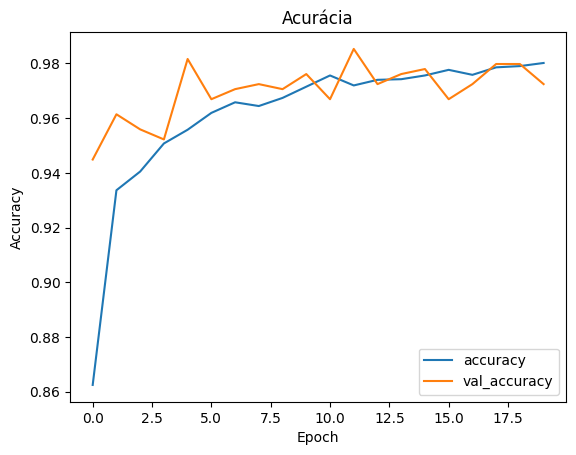

In [26]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Acurácia')
# plt.ylim([0.5, 1])
plt.legend(loc='lower right')

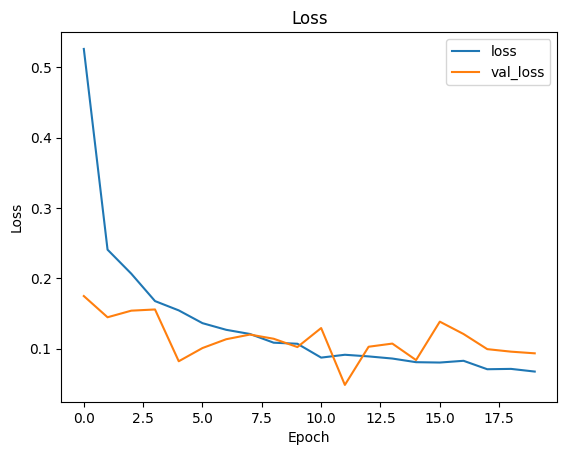

In [27]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss')
# plt.ylim([0.5, 1])
plt.legend(loc='upper right')


Avaliação do Modelo

In [28]:
# Avaliar o modelo nos dados de teste
test_loss, test_acc = model.evaluate(test_ds)
print(f'Test accuracy: {test_acc:.2f}')

17/17 [==============================] - 55s 2s/step - loss: 0.1986 - accuracy: 0.9467
Test accuracy: 0.95


Predição

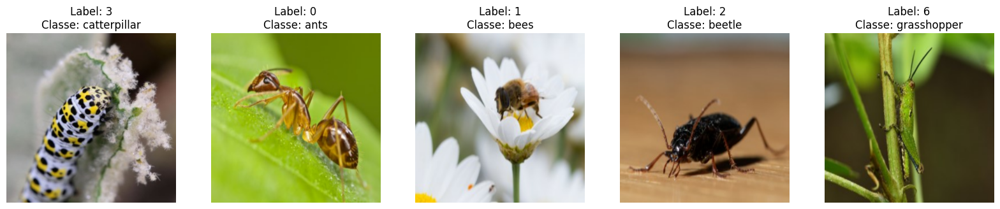

In [29]:
# Função para plotar uma amostra do dataset
plot_sample_from_dataset(test_ds, 5, class_names)

In [30]:
# Fazer previsões em todo o dataset de teste
predicted_class_indices = []
true_class_indices = []


for images, labels in test_ds:
    predictions = model.predict(images)
    predicted_class_indices.extend(np.argmax(predictions, axis=1))
    true_class_indices.extend(labels.numpy())

# Mapear os índices das classes preditas para os nomes das classes
predicted_class_names = [class_names[index] for index in predicted_class_indices]
print(predicted_class_indices )
print(predicted_class_names)

1/1 [==============================] - 1s 1s/step
[12, 0, 0, 12, 6, 5, 10, 7, 11, 6, 11, 0, 3, 6, 7, 2, 11, 3, 1, 11, 3, 4, 0, 1, 10, 6, 7, 12, 12, 3, 4, 2, 2, 12, 3, 6, 1, 11, 12, 11, 9, 0, 5, 12, 0, 7, 9, 12, 4, 7, 7, 0, 6, 4, 3, 0, 0, 12, 11, 10, 4, 11, 2, 7, 1, 5, 12, 10, 7, 10, 6, 9, 0, 1, 12, 6, 0, 0, 12, 2, 6, 12, 10, 0, 6, 3, 1, 7, 0, 6, 10, 10, 0, 11, 11, 6, 0, 6, 6, 11, 9, 1, 9, 2, 5, 11, 0, 3, 7, 12, 11, 7, 2, 11, 10, 12, 3, 7, 1, 0, 12, 11, 5, 10, 1, 0, 1, 12, 0, 4, 3, 11, 6, 3, 1, 2, 9, 3, 9, 9, 7, 5, 9, 12, 3, 2, 12, 0, 9, 1, 1, 11, 1, 9, 1, 2, 10, 12, 6, 10, 10, 3, 3, 12, 1, 12, 0, 10, 2, 2, 6, 7, 4, 5, 7, 2, 11, 2, 10, 7, 10, 11, 3, 12, 12, 4, 1, 6, 11, 0, 6, 1, 1, 6, 4, 9, 10, 0, 10, 0, 1, 10, 5, 11, 12, 1, 6, 10, 6, 6, 6, 9, 2, 1, 2, 4, 11, 10, 12, 11, 7, 5, 10, 1, 6, 2, 10, 11, 0, 4, 9, 10, 12, 11, 0, 2, 7, 5, 1, 3, 1, 12, 7, 3, 3, 0, 7, 2, 1, 7, 11, 6, 2, 0, 12, 4, 11, 1, 4, 6, 10, 2, 5, 3, 3, 12, 3, 9, 9, 10, 4, 12, 10, 11, 2, 9, 6, 7, 11, 0, 3, 12, 1, 4, 10, 10, 1

In [ ]:
# Adicionar uma dimensão extra para converter a imagem em um lote
image_pred = np.expand_dims(X_test[0], axis=0)

# Fazer uma previsão
predictions = model.predict(image_pred)

# Obter o índice da classe com a maior probabilidade
predicted_class_index = np.argmax(predictions)

print(predicted_class_index)
# Recuperar os nomes das classes
class_names = labels_encoder.classes_
print(class_names[predicted_class_index])

In [ ]:
class_names

['ants',
 'bees',
 'beetle',
 'catterpillar',
 'earthworms',
 'earwig',
 'grasshopper',
 'moth',
 'sample_data',
 'slug',
 'snail',
 'wasp',
 'weevil']

In [31]:
import numpy as np
from sklearn.preprocessing import LabelEncoder

labels_encoder = LabelEncoder()

# Ajustar o LabelEncoder e transformar os rótulos categóricos em numéricos
rotulos_numericos = labels_encoder.fit_transform(class_names)

print("Rótulos categóricos:", labels[:10])
print("Rótulos numéricos:", rotulos_numericos[:10])
print(rotulos_numericos.shape)


Rótulos categóricos: tf.Tensor([ 0 10  6 12  0 10  9 11  6  6], shape=(10,), dtype=int32)
Rótulos numéricos: [0 1 2 3 4 5 6 7 8 9]
(13,)


In [32]:
# Função para plotar uma amostra do dataset
def plot_predictions_test(dataset_test):
    class_names = labels_encoder.classes_


    plt.figure(figsize=(20, 20))
    i=0
    for images, labels in test_ds:
      predictions = model.predict(images)

      class_pred= np.argmax(predictions, axis=1)
      class_pred= class_names[class_pred]

      class_real= labels.numpy()
      class_real= class_names[class_real]



      #Plotando o Gráfico
      ax = plt.subplot(5, 5, i + 1)
      plt.imshow(images.numpy().astype("uint8"))
      plt.title(f'Imagem: {i}\nClasse Real: {class_real}\nClasse Predita: {class_pred}')
      plt.axis("off")
      i+=1
    plt.show()


In [33]:
import matplotlib.pyplot as plt

def plot_predictions_test(dataset_test, num_images):
    class_names = labels_encoder.classes_

    # Calcular o número total de imagens no dataset de teste
    total_images = sum(1 for _ in dataset_test.unbatch())
    if num_images > total_images:
        print(f"O número máximo de imagens é {total_images}.")
        num_images = total_images
        return

    plt.figure(figsize=(20, 20))
    count = 0
    for images, labels in dataset_test:
        predictions = model.predict(images)
        predicted_class_indices = np.argmax(predictions, axis=1)

        for i in range(num_images):
            image = images[i].numpy().astype("uint8")
            class_pred = class_names[predicted_class_indices[i]]
            class_real = class_names[labels.numpy()[i]]

            # Plotando o Gráfico
            ax = plt.subplot(5, 5, i + 1)
            plt.imshow(image)
            plt.title(f'Imagem: {i}\nClasse Real: {class_real}\nClasse Predita: {class_pred}')
            plt.axis("off")
    plt.show()



1/1 [==============================] - 1s 1s/step


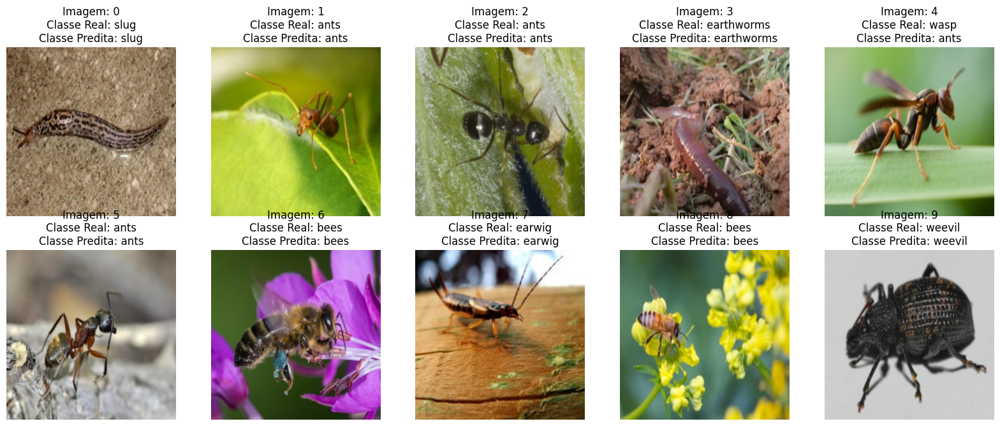

In [34]:
# Chamar a função com um número de imagens desejado
plot_predictions_test(test_ds, num_images=10)

In [35]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
from PIL import Image

def plot_predictions(imagem):
    # Carregar a imagem
    Imagem = Image.open(imagem)

    # Converter a imagem para um array NumPy com tamanho correto
    image = tf.keras.preprocessing.image.load_img(imagem, target_size=(512, 512))
    image_array = tf.keras.preprocessing.image.img_to_array(image)


    # Adicionar uma dimensão extra para converter a imagem em um lote
    image_batch = np.expand_dims(image_array, axis=0)

    # Fazer uma previsão
    predictions = model.predict(image_batch)

    # Obter o índice da classe com a maior probabilidade
    predicted_class_index = np.argmax(predictions)

    # Obter o nome da classe predita
    class_pred = class_names[predicted_class_index]

    # Obter a classe real a partir do caminho da imagem
    class_real = imagem.split('/')[2]

    # Plotar o Gráfico
    plt.imshow(Imagem)
    plt.title(f'Classe Real: {class_real}\nClasse Predita: {class_pred}')
    plt.axis("off")
    plt.show()



1/1 [==============================] - 9s 9s/step


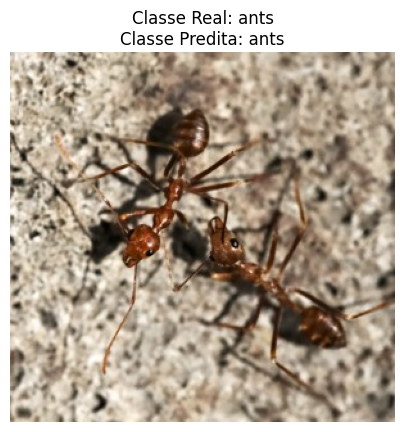

In [36]:
# Chamar a função com o caminho da imagem
imagem = '/content/ants/ants (1).jpg'
plot_predictions(imagem)


1/1 [==============================] - 0s 63ms/step


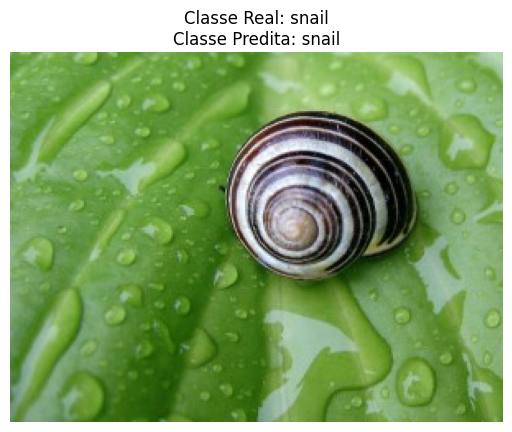

In [37]:
# Chamar a função com o caminho da imagem
imagem = '/content/snail/snail (1).jpg'
plot_predictions(imagem)


1/1 [==============================] - 0s 60ms/step


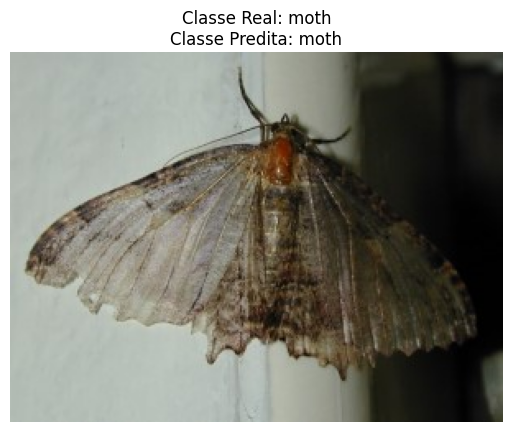

In [38]:
imagem = '/content/moth/moth (1).jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 97ms/step


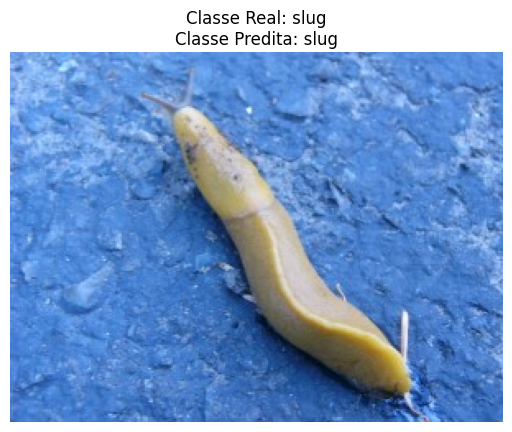

In [39]:
imagem = '/content/slug/slug (1).jpg'
plot_predictions(imagem)

In [40]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [41]:
import shutil

# Caminho do arquivo no Colab
src_path = '/content/best_model.h5'

# Caminho do destino no Google Drive
dest_path = '/content/drive/MyDrive/Datasets/Insetos/best_model.h5'

# Certifique-se de que o diretório de destino existe
shutil.copy(src_path, dest_path)

'/content/drive/MyDrive/Datasets/Insetos/best_model.h5'

In [42]:
# Carregar o modelo
model_path = '/content/drive/MyDrive/Datasets/Insetos/best_model.h5'
model_best = tf.keras.models.load_model(model_path)

In [44]:
# Avaliar o modelo nos dados de teste
test_loss, test_acc = model_best.evaluate(test_ds)
print(f'Test accuracy: {test_acc:.2f}')

17/17 [==============================] - 60s 2s/step - loss: 0.1946 - accuracy: 0.9522
Test accuracy: 0.95


In [45]:
import matplotlib.pyplot as plt

def plot_predictions_test(dataset_test, num_images):
    class_names = labels_encoder.classes_

    # Calcular o número total de imagens no dataset de teste
    total_images = sum(1 for _ in dataset_test.unbatch())
    if num_images > total_images:
        print(f"O número máximo de imagens é {total_images}.")
        num_images = total_images
        return

    plt.figure(figsize=(20, 20))
    count = 0
    for images, labels in dataset_test:
        predictions = model_best.predict(images)
        predicted_class_indices = np.argmax(predictions, axis=1)

        for i in range(num_images):
            image = images[i].numpy().astype("uint8")
            class_pred = class_names[predicted_class_indices[i]]
            class_real = class_names[labels.numpy()[i]]

            # Plotando o Gráfico
            ax = plt.subplot(5, 5, i + 1)
            plt.imshow(image)
            plt.title(f'Imagem: {i}\nClasse Real: {class_real}\nClasse Predita: {class_pred}')
            plt.axis("off")
    plt.show()


In [46]:
import matplotlib.pyplot as plt

def plot_predictions_test(dataset_test, num_images):
    class_names = labels_encoder.classes_

    # Calcular o número total de imagens no dataset de teste
    total_images = sum(1 for _ in dataset_test.unbatch())
    if num_images > total_images:
        print(f"O número máximo de imagens é {total_images}.")
        num_images = total_images
        return

    plt.figure(figsize=(20, 20))
    count = 0
    for images, labels in dataset_test:
        predictions = model_best.predict(images)
        predicted_class_indices = np.argmax(predictions, axis=1)

        for i in range(num_images):
            image = images[i].numpy().astype("uint8")
            class_pred = class_names[predicted_class_indices[i]]
            class_real = class_names[labels.numpy()[i]]

            # Plotando o Gráfico
            ax = plt.subplot(5, 5, i + 1)
            plt.imshow(image)
            plt.title(f'Imagem: {i}\nClasse Real: {class_real}\nClasse Predita: {class_pred}')
            plt.axis("off")
    plt.show()



1/1 [==============================] - 1s 1s/step


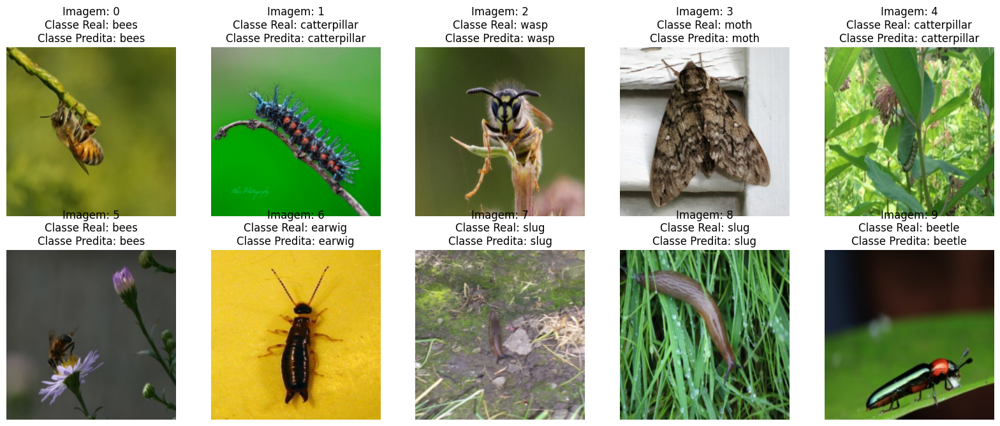

In [47]:
# Chamar a função com um número de imagens desejado
plot_predictions_test(test_ds, num_images=10)

In [48]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
from PIL import Image

def plot_predictions(imagem):
    # Carregar a imagem
    Imagem = Image.open(imagem)

    # Converter a imagem para um array NumPy com tamanho correto
    image = tf.keras.preprocessing.image.load_img(imagem, target_size=(512, 512))
    image_array = tf.keras.preprocessing.image.img_to_array(image)


    # Adicionar uma dimensão extra para converter a imagem em um lote
    image_batch = np.expand_dims(image_array, axis=0)

    # Fazer uma previsão
    predictions = model_best.predict(image_batch)

    # Obter o índice da classe com a maior probabilidade
    predicted_class_index = np.argmax(predictions)

    # Obter o nome da classe predita
    class_pred = class_names[predicted_class_index]

    # Obter a classe real a partir do caminho da imagem
    class_real = imagem.split('/')[2]

    # Plotar o Gráfico
    plt.imshow(Imagem)
    plt.title(f'Classe Real: {class_real}\nClasse Predita: {class_pred}')
    plt.axis("off")
    plt.show()



1/1 [==============================] - 7s 7s/step


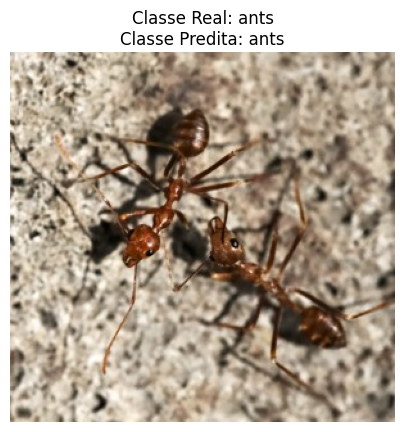

In [49]:
# Chamar a função com o caminho da imagem
imagem = '/content/ants/ants (1).jpg'
plot_predictions(imagem)


1/1 [==============================] - 0s 77ms/step


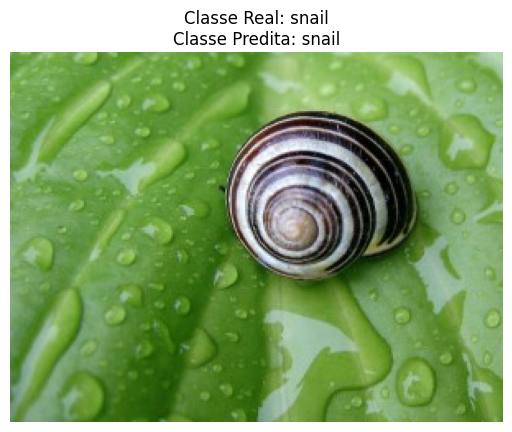

In [50]:
# Chamar a função com o caminho da imagem
imagem = '/content/snail/snail (1).jpg'
plot_predictions(imagem)


1/1 [==============================] - 0s 71ms/step


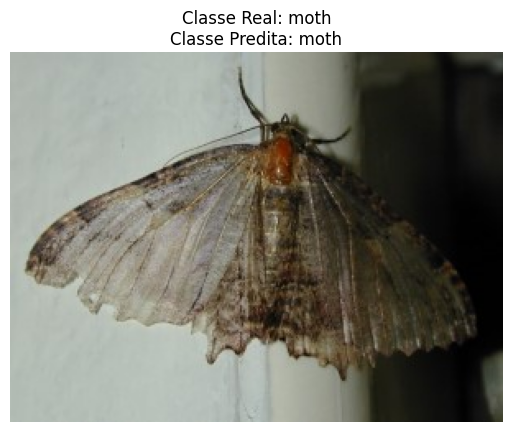

In [51]:
imagem = '/content/moth/moth (1).jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 81ms/step


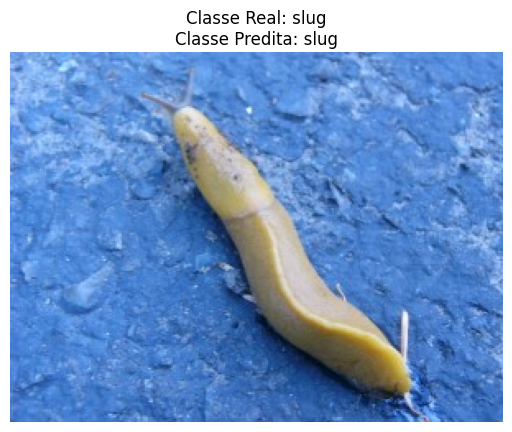

In [ ]:
imagem = '/content/slug/slug (1).jpg'
plot_predictions(imagem)

In [52]:
import shutil

# Caminho do arquivo no Colab
src_path = '/content/beetle_internet_1.jpg'

# Caminho do destino no Google Drive
dest_path = '/content/beetle/beetle_internet_1.jpg'

# Certifique-se de que o diretório de destino existe
shutil.copy(src_path, dest_path)

'/content/beetle/beetle_internet_1.jpg'

1/1 [==============================] - 0s 99ms/step


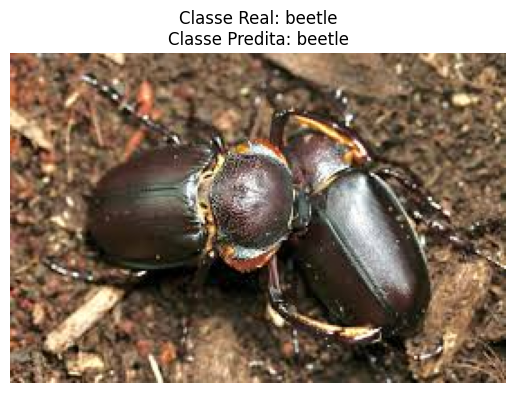

In [53]:
imagem = '/content/beetle/beetle_internet_1.jpg'
plot_predictions(imagem)

In [55]:
import shutil

# Caminho do arquivo no Colab
src_path = '/content/beetle_internet_2.jpg'

# Caminho do destino no Google Drive
dest_path = '/content/beetle/beetle_internet_2.jpg'

# Certifique-se de que o diretório de destino existe
shutil.copy(src_path, dest_path)

'/content/beetle/beetle_internet_2.jpg'

1/1 [==============================] - 0s 143ms/step


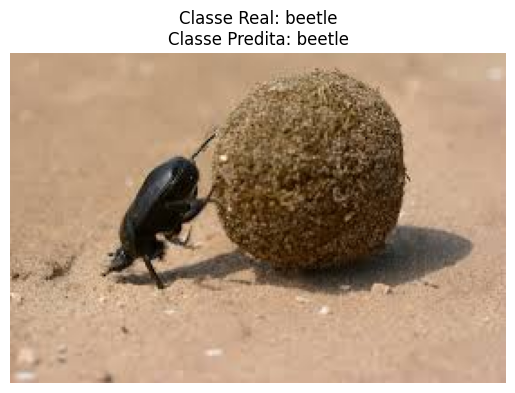

In [56]:
imagem = '/content/beetle/beetle_internet_2.jpg'
plot_predictions(imagem)

In [57]:
import shutil

# Caminho do arquivo no Colab
src_path = '/content/caterpillar_internet_1.jpg'

# Caminho do destino no Google Drive
dest_path = '/content/catterpillar/caterpillar_internet_1.jpg'

# Certifique-se de que o diretório de destino existe
shutil.copy(src_path, dest_path)

'/content/catterpillar/caterpillar_internet_1.jpg'

1/1 [==============================] - 0s 80ms/step


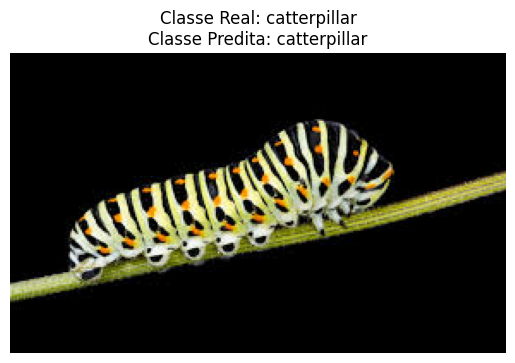

In [58]:
imagem = '/content/catterpillar/caterpillar_internet_1.jpg'
plot_predictions(imagem)

In [59]:
import shutil

# Caminho do arquivo no Colab
src_path = '/content/caterpillar_internet_2.jpg'

# Caminho do destino no Google Drive
dest_path = '/content/catterpillar/caterpillar_internet_2.jpg'

# Certifique-se de que o diretório de destino existe
shutil.copy(src_path, dest_path)

'/content/catterpillar/caterpillar_internet_2.jpg'

1/1 [==============================] - 0s 82ms/step


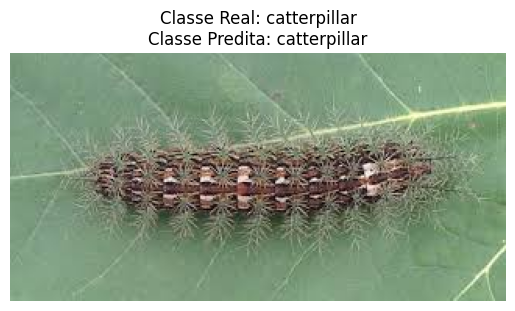

In [60]:
imagem = '/content/catterpillar/caterpillar_internet_2.jpg'
plot_predictions(imagem)

In [61]:
import shutil

# Caminho do arquivo no Colab
src_path = '/content/grasschper_internet_1.jpg'

# Caminho do destino no Google Drive
dest_path = '/content/grasshopper/grasschper_internet_1.jpg'

# Certifique-se de que o diretório de destino existe
shutil.copy(src_path, dest_path)

'/content/grasshopper/grasschper_internet_1.jpg'

1/1 [==============================] - 0s 83ms/step


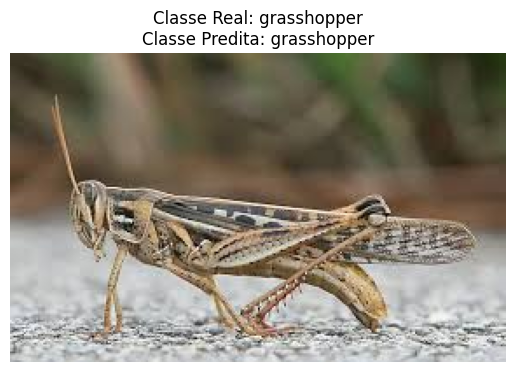

In [62]:
imagem = '/content/grasshopper/grasschper_internet_1.jpg'
plot_predictions(imagem)

In [63]:
import shutil

# Caminho do arquivo no Colab
src_path = '/content/grasschper_internet_2.jpg'

# Caminho do destino no Google Drive
dest_path = '/content/grasshopper/grasschper_internet_2.jpg'

# Certifique-se de que o diretório de destino existe
shutil.copy(src_path, dest_path)

'/content/grasshopper/grasschper_internet_2.jpg'

1/1 [==============================] - 0s 81ms/step


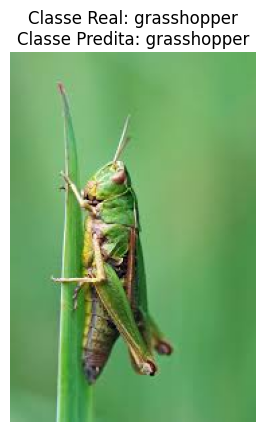

In [64]:
imagem = '/content/grasshopper/grasschper_internet_2.jpg'
plot_predictions(imagem)

In [65]:
import shutil

# Caminho do arquivo no Colab
src_path = '/content/moth_internet_1.jpg'

# Caminho do destino no Google Drive
dest_path = '/content/moth/moth_internet_1.jpg'

# Certifique-se de que o diretório de destino existe
shutil.copy(src_path, dest_path)

'/content/moth/moth_internet_1.jpg'

1/1 [==============================] - 0s 82ms/step


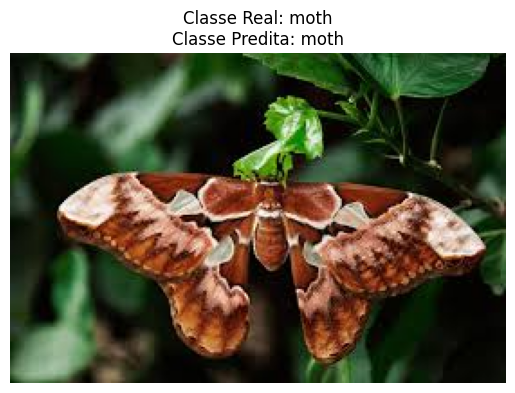

In [66]:
imagem = '/content/moth/moth_internet_1.jpg'
plot_predictions(imagem)

In [67]:
import shutil

# Caminho do arquivo no Colab
src_path = '/content/moth_internet_2.jpg'

# Caminho do destino no Google Drive
dest_path = '/content/moth/moth_internet_2.jpg'

# Certifique-se de que o diretório de destino existe
shutil.copy(src_path, dest_path)

'/content/moth/moth_internet_2.jpg'

1/1 [==============================] - 0s 80ms/step


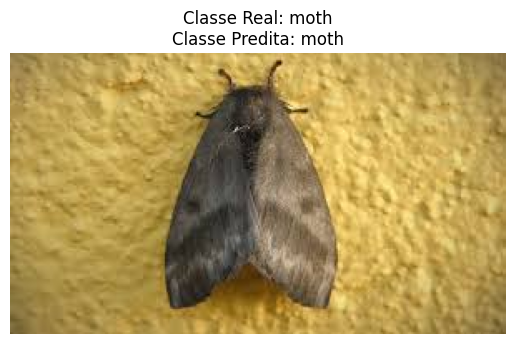

In [68]:
imagem = '/content/moth/moth_internet_2.jpg'
plot_predictions(imagem)

In [69]:
import shutil

# Caminho do arquivo no Colab
src_path = '/content/wasp_internet_1.jpg'

# Caminho do destino no Google Drive
dest_path = '/content/wasp/wasp_internet_1.jpg'

# Certifique-se de que o diretório de destino existe
shutil.copy(src_path, dest_path)

'/content/wasp/wasp_internet_1.jpg'

1/1 [==============================] - 0s 82ms/step


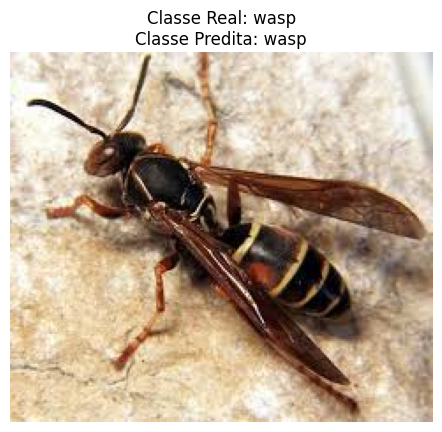

In [70]:
imagem = '/content/wasp/wasp_internet_1.jpg'
plot_predictions(imagem)

In [71]:
import shutil

# Caminho do arquivo no Colab
src_path = '/content/wasp_internet_2.jpg'

# Caminho do destino no Google Drive
dest_path = '/content/wasp/wasp_internet_2.jpg'

# Certifique-se de que o diretório de destino existe
shutil.copy(src_path, dest_path)

'/content/wasp/wasp_internet_2.jpg'

1/1 [==============================] - 0s 79ms/step


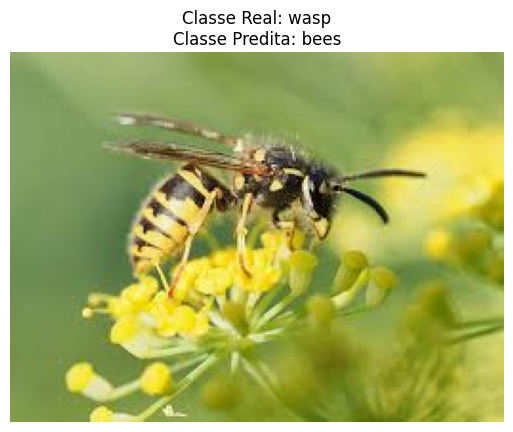

In [72]:
imagem = '/content/wasp/wasp_internet_2.jpg'
plot_predictions(imagem)

In [ ]:
# Treine o modelo
history = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=20,
    callbacks=[checkpoint_callback]

)

Epoch 1/20
137/137 [==============================] - ETA: 0s - loss: 0.5261 - accuracy: 0.8625

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


137/137 [==============================] - 384s 3s/step - loss: 0.5261 - accuracy: 0.8625 - val_loss: 0.1749 - val_accuracy: 0.9449
Epoch 2/20
137/137 [==============================] - 335s 2s/step - loss: 0.2409 - accuracy: 0.9336 - val_loss: 0.1448 - val_accuracy: 0.9614
Epoch 3/20
137/137 [==============================] - 322s 2s/step - loss: 0.2067 - accuracy: 0.9405 - val_loss: 0.1542 - val_accuracy: 0.9559
Epoch 4/20
137/137 [==============================] - 325s 2s/step - loss: 0.1678 - accuracy: 0.9507 - val_loss: 0.1559 - val_accuracy: 0.9522
Epoch 5/20
137/137 [==============================] - 333s 2s/step - loss: 0.1546 - accuracy: 0.9557 - val_loss: 0.0823 - val_accuracy: 0.9816
Epoch 6/20
137/137 [==============================] - 356s 3s/step - loss: 0.1364 - accuracy: 0.9619 - val_loss: 0.1011 - val_accuracy: 0.9669
Epoch 7/20
137/137 [==============================] - 324s 2s/step - loss: 0.1270 - accuracy: 0.9658 - val_loss: 0.1136 - val_accuracy: 0.9706
Epoch 8/20

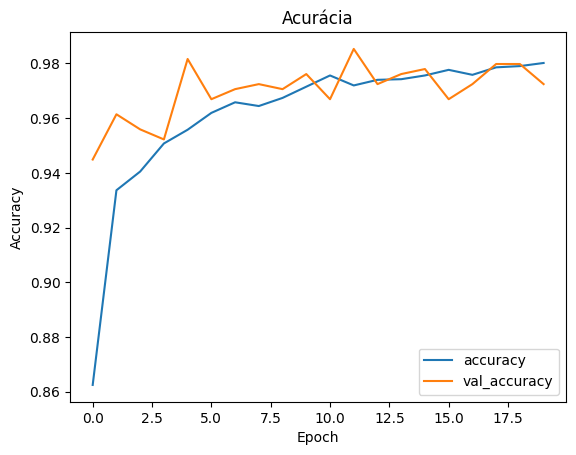

In [ ]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Acurácia')
# plt.ylim([0.5, 1])
plt.legend(loc='lower right')

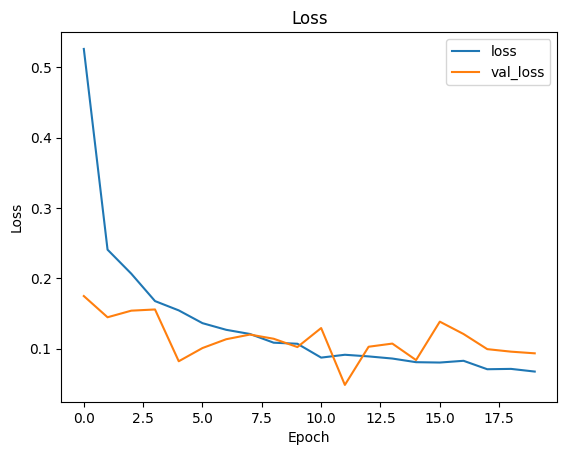

In [ ]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss')
# plt.ylim([0.5, 1])
plt.legend(loc='upper right')


In [ ]:
# Avaliar o modelo nos dados de teste
test_loss, test_acc = model.evaluate(test_ds)
print(f'Test accuracy: {test_acc:.2f}')

17/17 [==============================] - 55s 2s/step - loss: 0.1986 - accuracy: 0.9467
Test accuracy: 0.95


1/1 [==============================] - 1s 1s/step


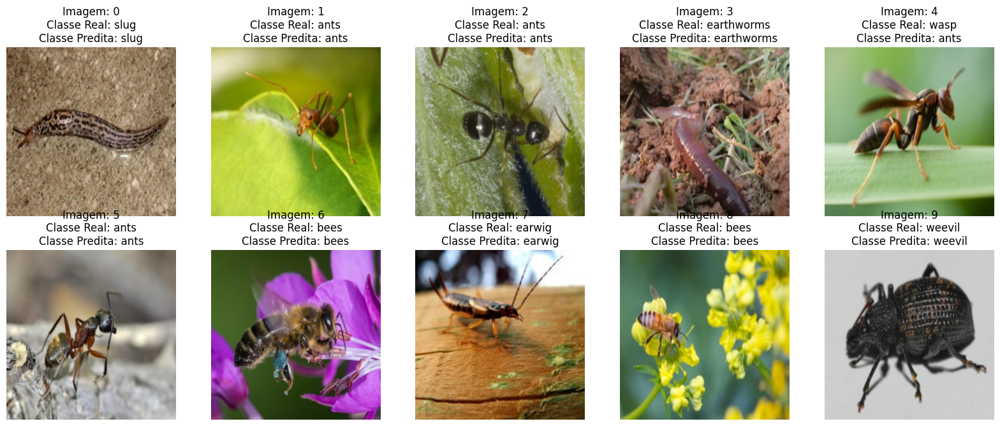

In [ ]:
# Chamar a função com um número de imagens desejado
plot_predictions_test(test_ds, num_images=10)

1/1 [==============================] - 1s 1s/step


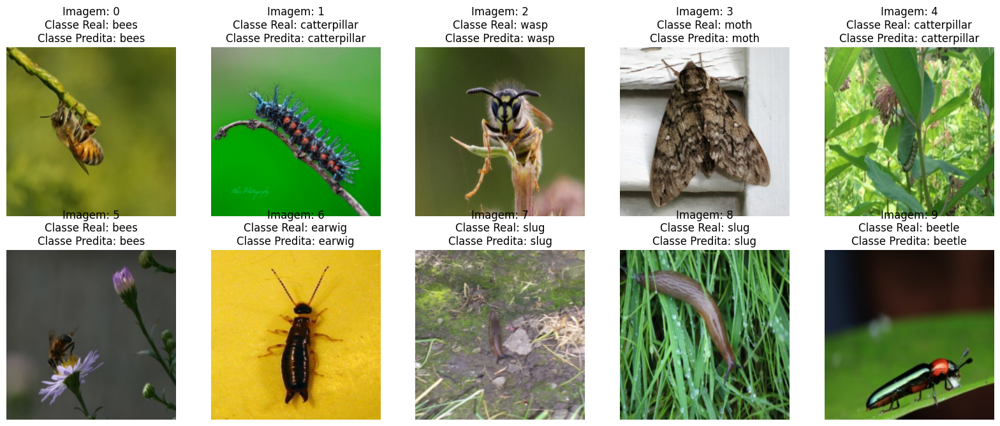

In [ ]:
# Chamar a função com um número de imagens desejado
plot_predictions_test(test_ds, num_images=10)

1/1 [==============================] - 9s 9s/step


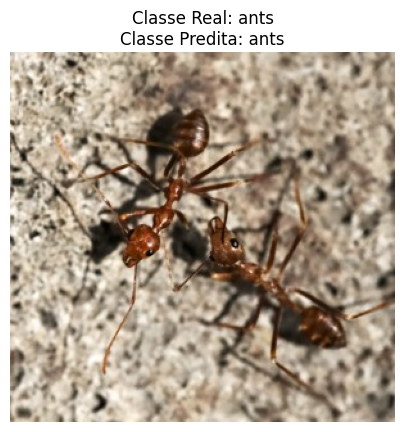

In [ ]:
# Chamar a função com o caminho da imagem
imagem = '/content/ants/ants (1).jpg'
plot_predictions(imagem)


1/1 [==============================] - 0s 63ms/step


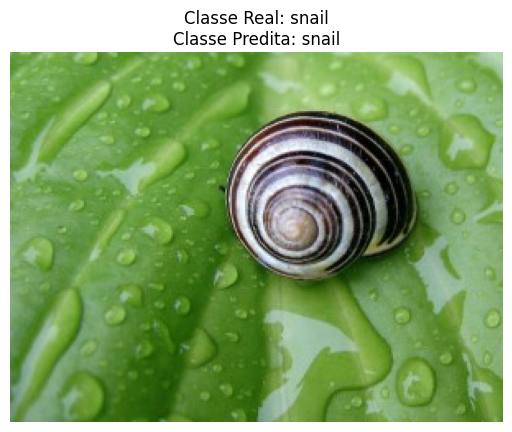

In [ ]:
# Chamar a função com o caminho da imagem
imagem = '/content/snail/snail (1).jpg'
plot_predictions(imagem)


1/1 [==============================] - 0s 60ms/step


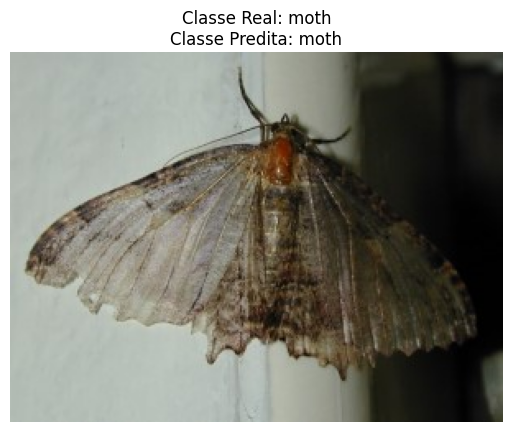

In [ ]:
imagem = '/content/moth/moth (1).jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 97ms/step


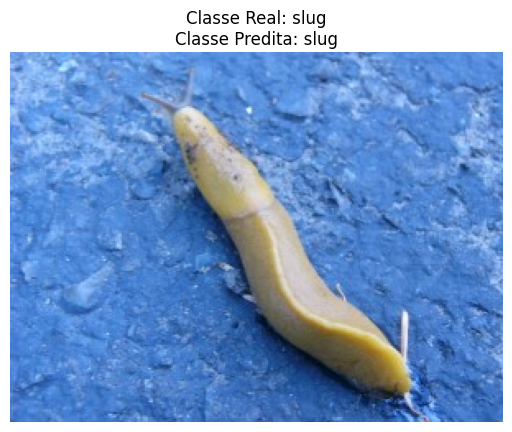

In [ ]:
imagem = '/content/slug/slug (1).jpg'
plot_predictions(imagem)

**Predições de Imagens da Internet**

1/1 [==============================] - 0s 99ms/step


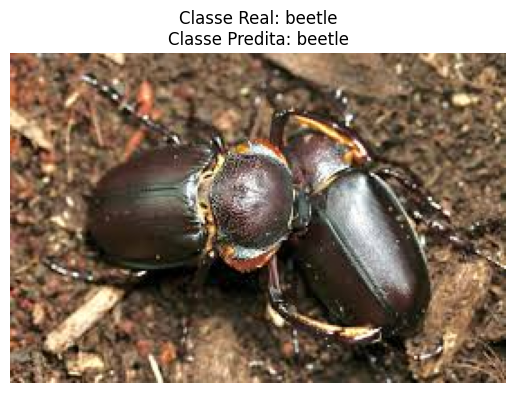

In [ ]:
imagem = '/content/beetle/beetle_internet_1.jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 143ms/step


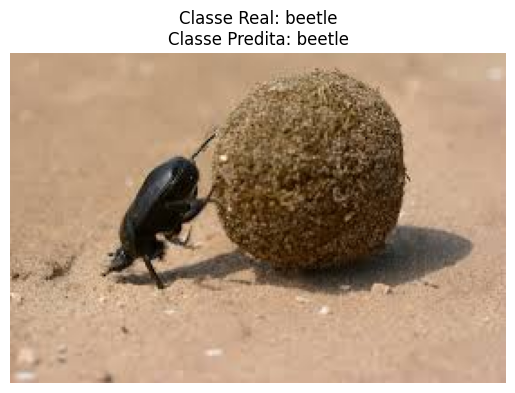

In [ ]:
imagem = '/content/beetle/beetle_internet_2.jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 80ms/step


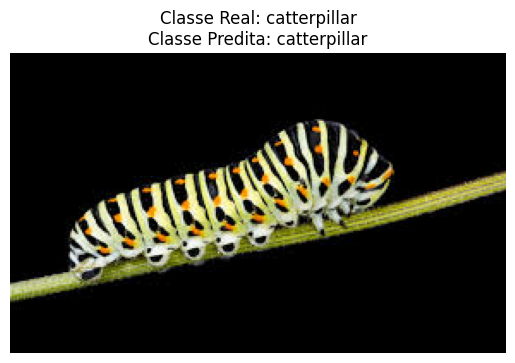

In [ ]:
imagem = '/content/catterpillar/caterpillar_internet_1.jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 82ms/step


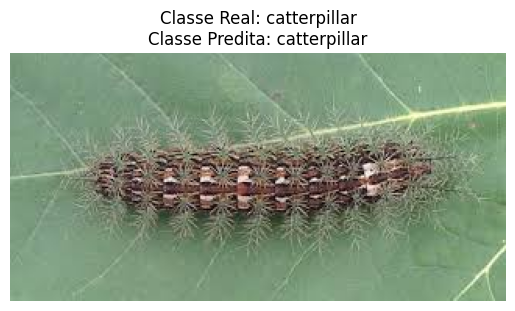

In [ ]:
imagem = '/content/catterpillar/caterpillar_internet_2.jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 83ms/step


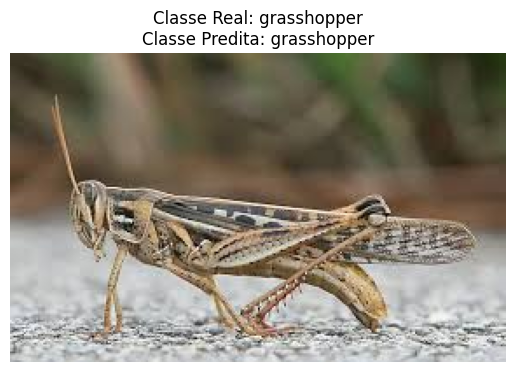

In [ ]:
imagem = '/content/grasshopper/grasschper_internet_1.jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 81ms/step


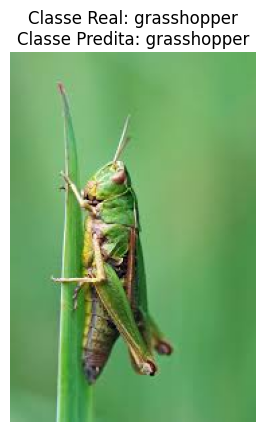

In [ ]:
imagem = '/content/grasshopper/grasschper_internet_2.jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 82ms/step


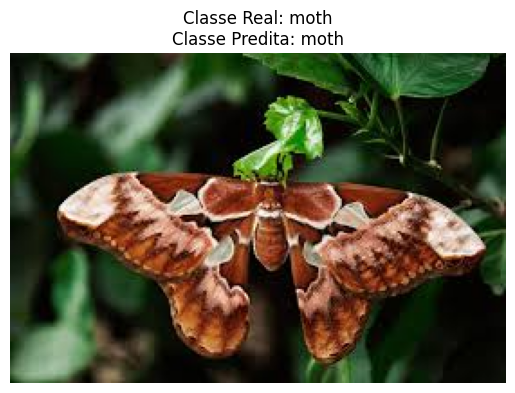

In [ ]:
imagem = '/content/moth/moth_internet_1.jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 80ms/step


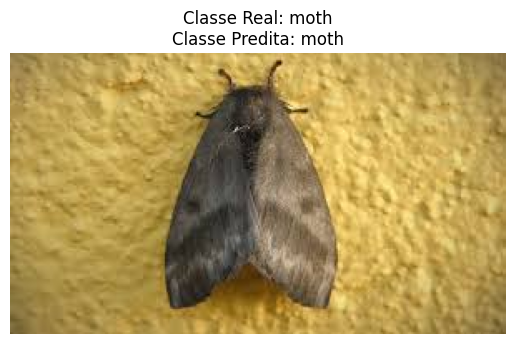

In [ ]:
imagem = '/content/moth/moth_internet_2.jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 82ms/step


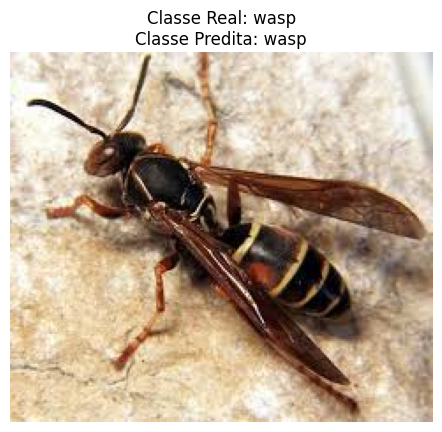

In [ ]:
imagem = '/content/wasp/wasp_internet_1.jpg'
plot_predictions(imagem)

1/1 [==============================] - 0s 79ms/step


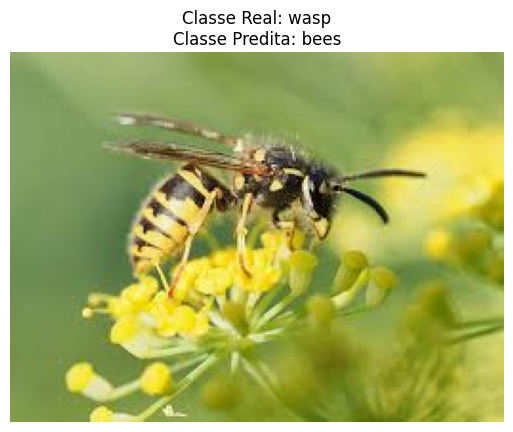

In [ ]:
imagem = '/content/wasp/wasp_internet_2.jpg'
plot_predictions(imagem)